<a href="https://colab.research.google.com/github/LasseFrie/Otterly/blob/main/OtterGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# An otterly cute GAN Model by Lasse Friedrich (9924680)

In this notebook I explore the implementation from scratch for a GAN Model aimed at creating cute otter pictures, trained on 1.5k (upsampled 2k) otter images. I also then compare my results on a high level to a prebuilt Diffusion Model.

**Results:**
- GANs seem to approach generation via more and more detailed "blockier" images, while the Diffusion seems to do this via decreasing blur
- For the data choosen, GANs provide significant better results, even though recognizing otters in it is still hard
- The dataset seems quite volatile and small so neither the GAN nor the Diffusion could sufficiently generalize
- Google Colab seems to significantly optimize convolutional model training, working several times faster then local CUDA enhanced training

**Sources:**
- Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks [[Radford.2015]](https://arxiv.org/pdf/1511.06434)
- Otter Dataset drawn from [images.cv](https://images.cv/dataset/otter-image-classification-dataset)
- Implementation Inspiration drawn from [Aladdin Persson](https://www.youtube.com/watch?v=IZtv9s_Wx9I)
- Originally Trained in [Colab](https://colab.research.google.com/drive/1h0VOc09SRoJeNuVFvUVRYV0rat0-QuVg?usp=sharing)

## 1. GAN Results in Tensorboard
For visualization of the trained GAN, tensorboard logs are being used. Simply start a tensorboard session while pointing at the logs folder to instantely see the results.

In [ ]:
%tensorboard --logdir logs
%load_ext tensorboard

## 2. Data Loading
I unpacked all the otter images onto one hierarchically equal layer within a data folder.

In [3]:
from torchvision.datasets import VisionDataset
from torchvision.transforms import transforms
from PIL import Image
import os

data_path = '/content/drive/MyDrive/data'

class OtterDataset(VisionDataset):
    def __init__(self, root, transform=None, target_transform=None):
        super().__init__(root, transform=transform, target_transform=target_transform)
        self.data_dir = os.path.join(root)
        self.images = [os.path.join(self.data_dir, img) for img in os.listdir(self.data_dir) if img.endswith('.jpg')]

    def __getitem__(self, index):
        img_path = self.images[index]
        img_name = os.path.basename(img_path)  # Get the filename with extension
        label = os.path.splitext(img_name)[0]  # Remove the extension from the filename

        try:
            # Load image
            with open(img_path, 'rb') as f:
                img = Image.open(f)
                img = img.convert('RGB')

            # Apply transformation
            if self.transform is not None:
                img = self.transform(img)

            if self.target_transform is not None:
                label = self.target_transform(label)

            return img, label

        # Handle cases where the image cannot be opened or processed
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            return None


    def __len__(self):
        return len(self.images)

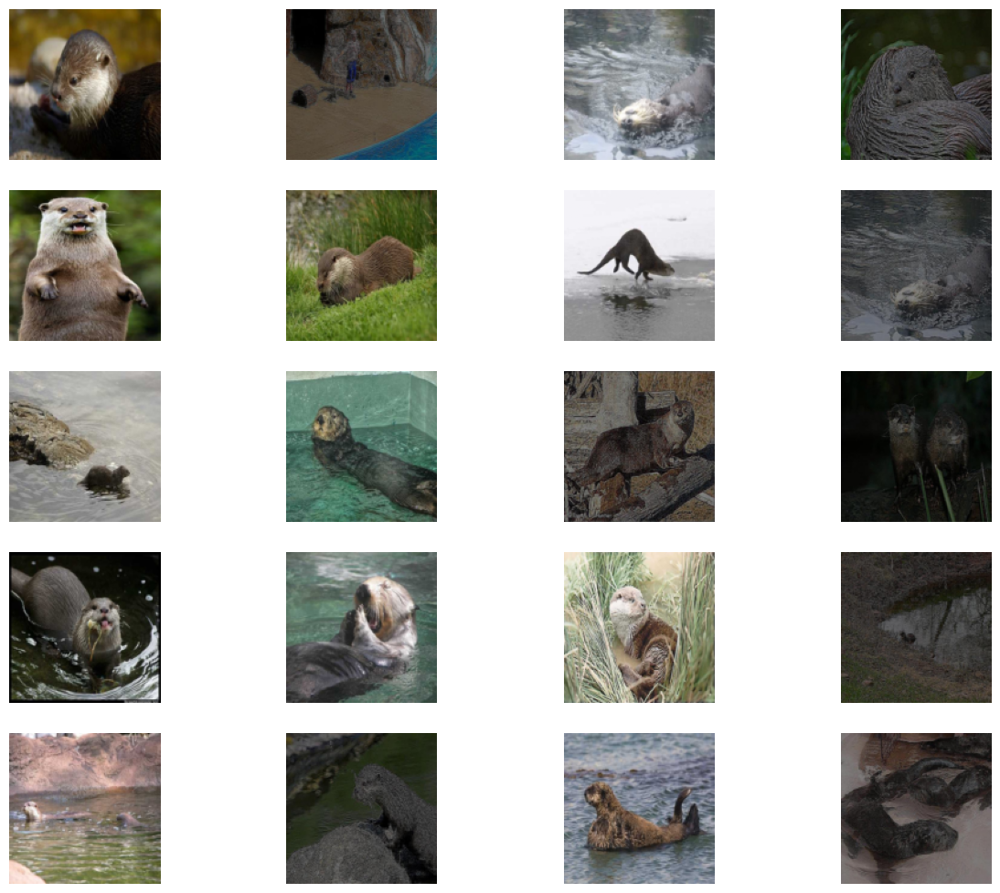

In [6]:
import torch
import torchvision
import matplotlib.pyplot as plt

def show_images(dataset, num_samples=20, cols=4):
    plt.figure(figsize=(15,15))
    for i, (img, _) in enumerate(dataset):  
        if i == num_samples:
            break
        img = img.permute(1, 2, 0)  # Change from (C, H, W) to (H, W, C)
        plt.subplot(int(num_samples / cols) + 1, cols, i + 1)
        plt.imshow(img.numpy())  # Convert tensor to numpy array for imshow
        plt.axis('off')  
    plt.show()

transform = transforms.Compose([
      transforms.Resize((128, 128)),
      transforms.ToTensor(),
])

data = OtterDataset(root=data_path, transform=transform)
show_images(dataset=data)

## 3. GAN Implementation

In [5]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # Initial convolutional layer to process input image
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=2),
            nn.LeakyReLU(0.2),  # Activation function
            # Subsequent convolutional blocks with increasing features
            self._block(features_d, features_d*2, 4, 2, 2),
            self._block(features_d*2, features_d*4, 4, 2, 1),
            self._block(features_d*4, features_d*8, 4, 2, 1),
            # Final convolutional layer to output a single value
            nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()  # Activation function to output probability
        )

    # Helper method to create a convolutional block
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.BatchNorm2d(out_channels),  # Batch normalization for stability
            nn.LeakyReLU(0.2)  # Activation function
        )

    # Forward pass through the network
    def forward(self, x):
        return self.disc(x)

# Define the Generator class, which inherits from nn.Module
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            # Input layer, z_dim to a 4x4 feature map
            self._block(z_dim, features_g * 16, 4, 1, 0),  # Output size: (features_g * 16) x 4 x 4
            self._block(features_g * 16, features_g * 8, 4, 2, 1),  # Output size: (features_g * 8) x 8 x 8
            self._block(features_g * 8, features_g * 4, 4, 2, 1),  # Output size: (features_g * 4) x 16 x 16
            self._block(features_g * 4, features_g * 2, 4, 2, 1),  # Output size: (features_g * 2) x 32 x 32
            # Final layer to output image
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),  # Output size: channels_img x 64 x 64
            nn.Tanh()  # Normalize the output to range [-1, 1]
        )

    # Helper method to create a transposed convolutional block
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),  # Batch normalization for stability
            nn.ReLU()  # Activation function
        )

    # Forward pass through the network
    def forward(self, x):
        return self.gen(x)

# Initialize weights of the network layers
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

# Test function to ensure the models work as expected
def test():
    N, in_channels, H, W = 8, 3, 64, 64  # Batch size, number of channels, height, and width
    z_dim = 100  # Dimension of the input noise vector
    x = torch.randn((N, in_channels, H, W))  # Random input tensor for the discriminator
    disc = Discriminator(in_channels, 8)  # Instantiate the discriminator
    initialize_weights(disc)  # Initialize weights
    assert disc(x).shape == (N, 1, 1, 1)  # Check output shape of the discriminator
    gen = Generator(z_dim, in_channels, 8)  # Instantiate the generator
    initialize_weights(gen)  # Initialize weights
    z = torch.randn((N, z_dim, 1, 1))  # Random noise tensor for the generator
    assert gen(z).shape == (N, in_channels, H, W)  # Check output shape of the generator
    print("Success")

test()  # Run the test function

Success


## 4. GAN Training

In [ ]:
import torch.optim as torch_optim
import torch as torch_lib
import torchvision as torch_vision
import torchvision.transforms as torch_transforms
from torch.utils.tensorboard import SummaryWriter as TorchSummaryWriter
from torch.utils.data import DataLoader as TorchDataLoader

%load_ext tensorboard
%tensorboard --logdir logs

torch_device = torch_lib.device("cuda" if torch_lib.cuda.is_available() else "cpu")
LEARNING_RATE_VAL = 5e-4
BATCH_SIZE_VAL = 128
IMAGE_DIM = 64
NUM_CHANNELS_IMG = 3
NOISE_DIM = 100
EPOCHS_NUM = 200
DISC_FEATURES = 64
GEN_FEATURES = 64

# Resize and normalize the images
data_transforms = torch_transforms.Compose([
    torch_transforms.Resize((IMAGE_DIM, IMAGE_DIM)),
    torch_transforms.ToTensor(),
    torch_transforms.Normalize([0.5 for _ in range(NUM_CHANNELS_IMG)], [0.5 for _ in range(NUM_CHANNELS_IMG)]),
])

# Make sure to properly unzip the data
data_set = OtterDataset(root=data_path, transform=data_transforms)
data_loader = TorchDataLoader(data_set, batch_size=BATCH_SIZE_VAL, shuffle=True)

generator_model = Generator(NOISE_DIM, NUM_CHANNELS_IMG, GEN_FEATURES).to(torch_device)
discriminator_model = Discriminator(NUM_CHANNELS_IMG, DISC_FEATURES).to(torch_device)

initialize_weights(generator_model)
initialize_weights(discriminator_model)

# Use Adam optimizer for fast convergence
optimizer_gen = torch_optim.Adam(generator_model.parameters(), lr=LEARNING_RATE_VAL, betas=(0.5, 0.999))
optimizer_disc = torch_optim.Adam(discriminator_model.parameters(), lr=LEARNING_RATE_VAL, betas=(0.5, 0.999))

# Define the loss function for binary classification cross entropy
loss_function = nn.BCELoss()

# Generate a fixed noise vector for consistent evaluation of the generator's progress
fixed_noise_vec = torch_lib.randn(32, NOISE_DIM, 1, 1).to(torch_device)
writer_real_img = TorchSummaryWriter(f"logs/real")
writer_fake_img = TorchSummaryWriter(f"logs/fake")
global_step = 0

# Set the models to training mode
generator_model.train()
discriminator_model.train()

# Start the training loop for the defined number of epochs
for epoch_num in range(EPOCHS_NUM):
    # Loop over the data loader and batch through the dataset
    for batch_index, (real_imgs, _) in enumerate(data_loader):

        # Generator uses random noise to create fake images
        real_imgs = real_imgs.to(torch_device)
        noise_vec = torch_lib.randn((BATCH_SIZE_VAL, NOISE_DIM, 1, 1)).to(torch_device)
        fake_imgs = generator_model(noise_vec)

        # Pass real images through the discriminator and flatten the output
        disc_real_output = discriminator_model(real_imgs).reshape(-1)

        # Compute the discriminator's loss on real images
        # Using Binary Cross-Entropy Loss with real labels (1s)
        loss_disc_real = loss_function(disc_real_output, torch_lib.ones_like(disc_real_output))

        # Pass fake images generated by the generator through the discriminator and flatten the output
        disc_fake_output = discriminator_model(fake_imgs).reshape(-1)

        # Compute the discriminator's loss on fake images
        # Using Binary Cross-Entropy Loss with fake labels (0s)
        loss_disc_fake = loss_function(disc_fake_output, torch_lib.zeros_like(disc_fake_output))

        # Combine the losses for real and fake images to get the total discriminator loss
        total_loss_disc = (loss_disc_real + loss_disc_fake) / 2

        # Zero the gradients of the discriminator's parameters to prepare for backpropagation
        discriminator_model.zero_grad()

        # Backpropagate the discriminator loss to compute the gradients
        # retain_graph=True is used to retain the computation graph for the generator's backward pass
        total_loss_disc.backward(retain_graph=True)

        # Update the discriminator's parameters using the gradients computed
        optimizer_disc.step()

        # Pass fake images generated by the generator through the discriminator and flatten the output
        gen_output = discriminator_model(fake_imgs).reshape(-1)

        # Compute the generator's loss
        # Using Binary Cross-Entropy Loss with real labels (1s)
        loss_gen = loss_function(gen_output, torch_lib.ones_like(gen_output))

        # Zero the gradients of the generator's parameters to prepare for backpropagation
        generator_model.zero_grad()

        # Backpropagate the generator loss to compute the gradients
        loss_gen.backward()

        # Update the generator's parameters using the gradients computed
        optimizer_gen.step()

        # Print the losses and save the generated images every 100 steps
        if batch_index % 100 == 0:
            print(f"Epoch [{epoch_num}/{EPOCHS_NUM}] Batch {batch_index}/{len(data_loader)} \
            Loss D: {total_loss_disc:.4f}, loss G: {loss_gen:.4f}")

            with torch_lib.no_grad():
                fake_imgs = generator_model(fixed_noise_vec)
                img_grid_real = torch_vision.utils.make_grid(real_imgs[:32], normalize=True)
                img_grid_fake = torch_vision.utils.make_grid(fake_imgs[:32], normalize=True)

                writer_real_img.add_image("REAL", img_grid_real, global_step=global_step)
                writer_fake_img.add_image("FAKE", img_grid_fake, global_step=global_step)
                writer_real_img.add_scalar("REAL LOSS", total_loss_disc, global_step=global_step)
                writer_real_img.add_scalar("FAKE LOSS", loss_gen, global_step=global_step)

            global_step += 1

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

Epoch [0/200] Batch 0/17             Loss D: 0.6975, loss G: 0.8500
Epoch [1/200] Batch 0/17             Loss D: 0.0851, loss G: 2.6349
Epoch [2/200] Batch 0/17             Loss D: 0.2367, loss G: 2.6144
Epoch [3/200] Batch 0/17             Loss D: 0.1399, loss G: 2.4640
Epoch [4/200] Batch 0/17             Loss D: 0.0239, loss G: 3.8251
Epoch [5/200] Batch 0/17             Loss D: 0.7966, loss G: 1.5024
Epoch [6/200] Batch 0/17             Loss D: 0.7783, loss G: 1.1771
Epoch [7/200] Batch 0/17             Loss D: 0.3302, loss G: 2.6955
Epoch [8/200] Batch 0/17             Loss D: 0.4604, loss G: 2.3825
Epoch [9/200] Batch 0/17             Loss D: 0.5453, loss G: 1.8937
Epoch [10/200] Batch 0/17             Loss D: 0.7025, loss G: 1.4322
Epoch [11/200] Batch 0/17             Loss D: 0.5705, loss G: 1.8683
Epoch [12/200] Batch 0/17             Loss D: 0.5969, loss G: 2.3434
Epoch [13/200] Batch 0/17             Loss D: 0.5121, loss G: 1.2045
Epoch [14/200] Batch 0/17             Loss D

## 5. Comparison to simple Diffusion

**Sources:**
- Youtube Inspiration [Diffusion Models from scratch](https://www.youtube.com/watch?v=a4Yfz2FxXiY)
- Github implementation [Denoising Diffusion Pytorch](https://github.com/lucidrains/denoising-diffusion-pytorch)
- Niels Rogge, Kashif Rasul, [Huggingface notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/examples/annotated_diffusion.ipynb#scrollTo=3a159023)
- Papers on Diffusion models ([Dhariwal, Nichol, 2021], [Ho et al., 2020] etc.)

## 6. Noise and Helper Functions


In [ ]:
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

## 7. Forward Test

In [ ]:
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 64
BATCH_SIZE = 128

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    data = OtterDataset(root=data_path, transform=data_transform)
    return torch.utils.data.ConcatDataset([data])

def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

<ipython-input-5-f4853fe96c6f>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


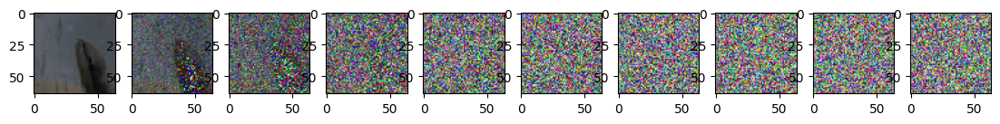

In [ ]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

## 8. UNET Model Implementation

In [ ]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [ ]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

## 9. Diffusion Training

Epoch 0 | step 000 Loss: 0.8114885091781616 


<ipython-input-8-23d9a600a066>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


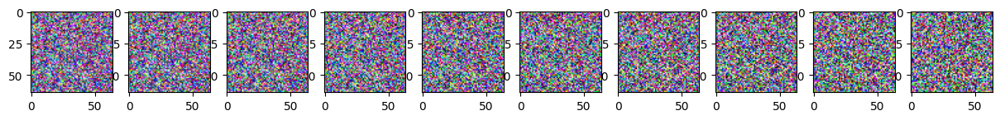

Epoch 5 | step 000 Loss: 0.24517510831356049 


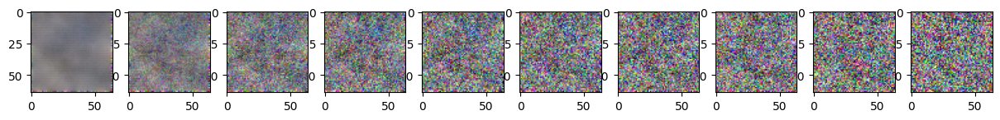

Epoch 10 | step 000 Loss: 0.20578253269195557 


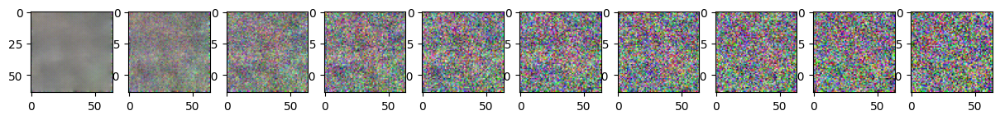

Epoch 15 | step 000 Loss: 0.18601977825164795 


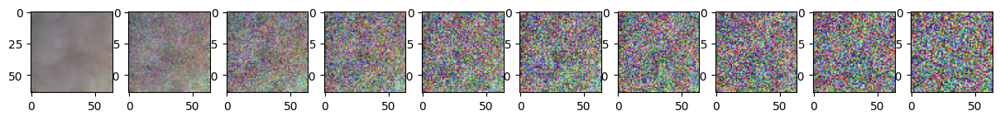

Epoch 20 | step 000 Loss: 0.15512773394584656 


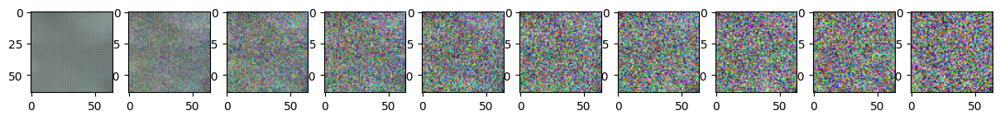

Epoch 25 | step 000 Loss: 0.15137949585914612 


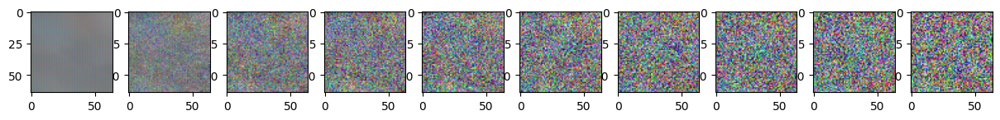

Epoch 30 | step 000 Loss: 0.2079945057630539 


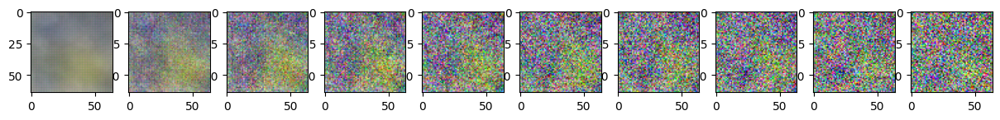

Epoch 35 | step 000 Loss: 0.15116748213768005 


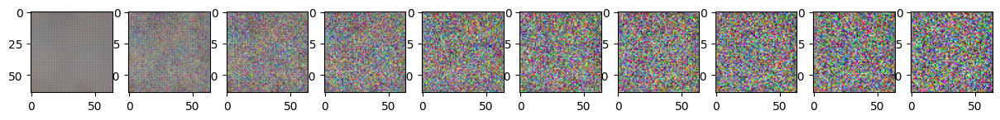

Epoch 40 | step 000 Loss: 0.1443890631198883 


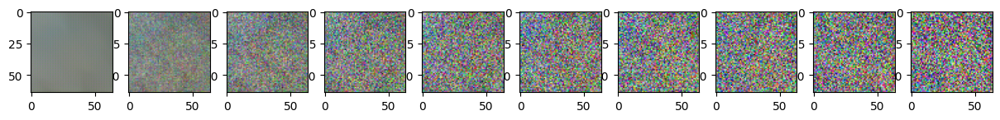

Epoch 45 | step 000 Loss: 0.1366153210401535 


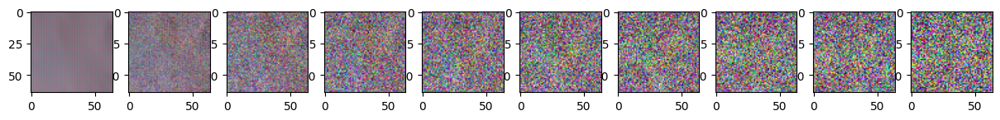

Epoch 50 | step 000 Loss: 0.13994966447353363 


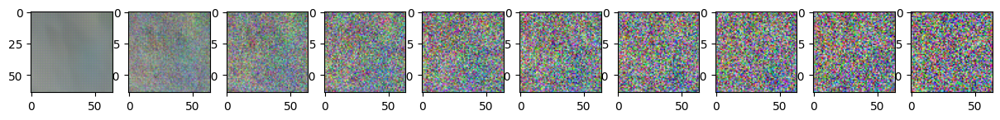

Epoch 55 | step 000 Loss: 0.14554783701896667 


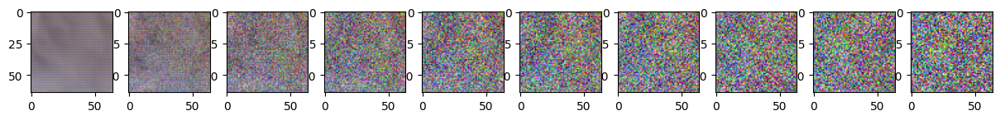

Epoch 60 | step 000 Loss: 0.13664093613624573 


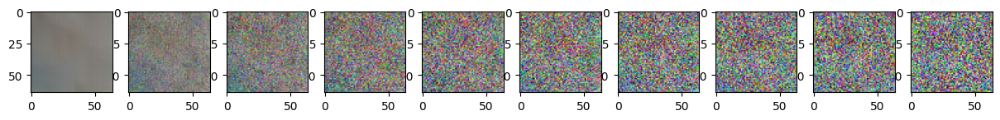

Epoch 65 | step 000 Loss: 0.14233164489269257 


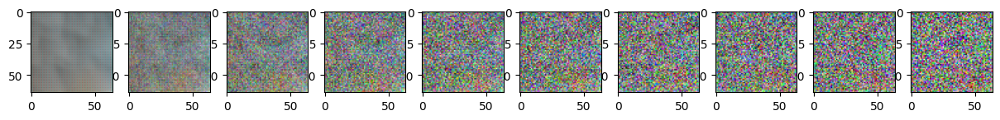

Epoch 70 | step 000 Loss: 0.14333373308181763 


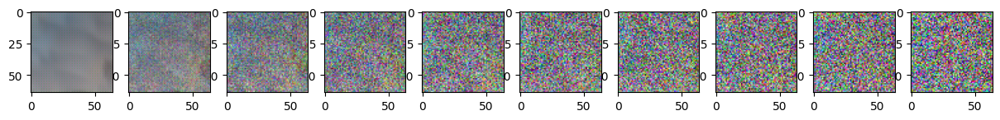

Epoch 75 | step 000 Loss: 0.14520737528800964 


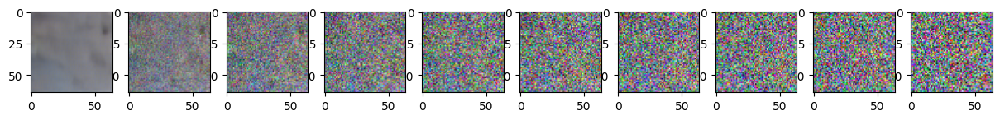

Epoch 80 | step 000 Loss: 0.13840679824352264 


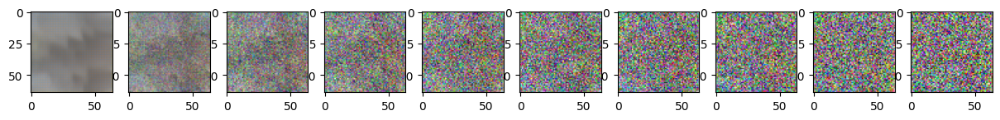

Epoch 85 | step 000 Loss: 0.1363222897052765 


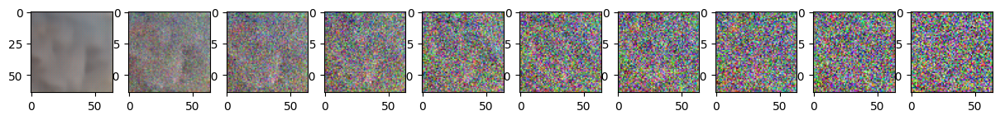

Epoch 90 | step 000 Loss: 0.14141136407852173 


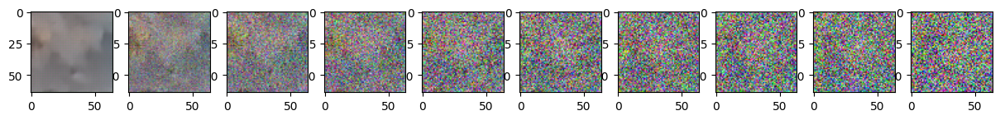

Epoch 95 | step 000 Loss: 0.14798325300216675 


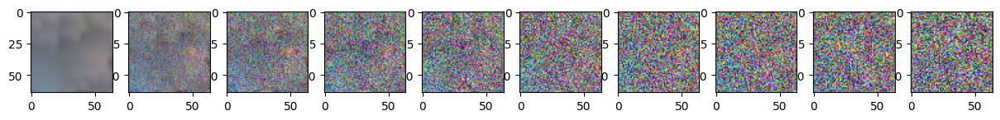

Epoch 100 | step 000 Loss: 0.13823601603507996 


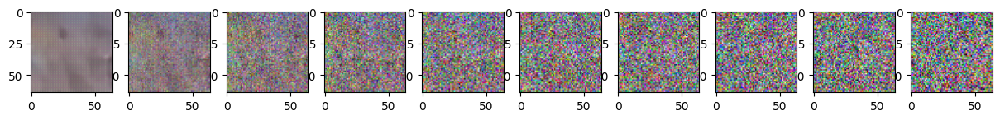

Epoch 105 | step 000 Loss: 0.14449487626552582 


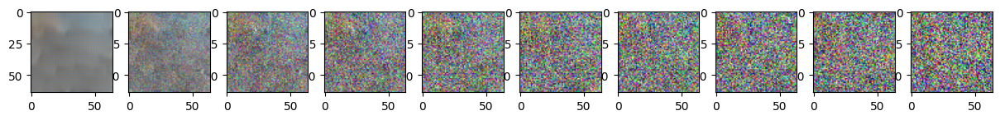

Epoch 110 | step 000 Loss: 0.1198960542678833 


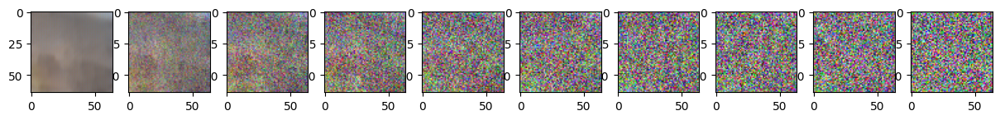

Epoch 115 | step 000 Loss: 0.12775948643684387 


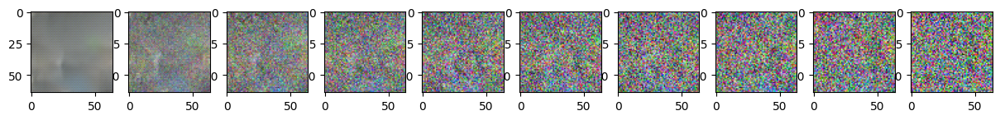

Epoch 120 | step 000 Loss: 0.1251991242170334 


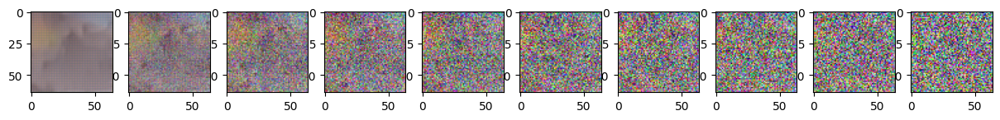

Epoch 125 | step 000 Loss: 0.1348537802696228 


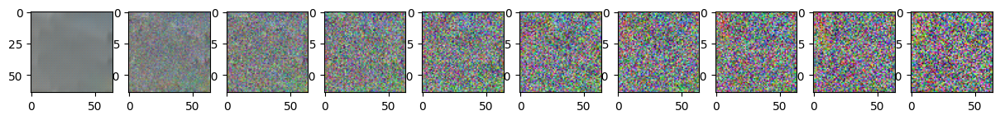

Epoch 130 | step 000 Loss: 0.13707447052001953 


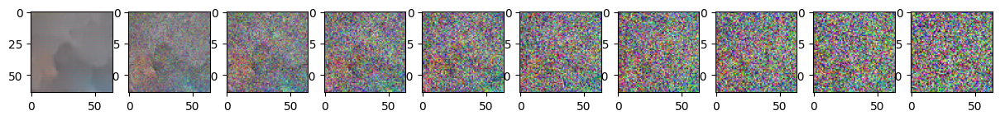

Epoch 135 | step 000 Loss: 0.14028416574001312 


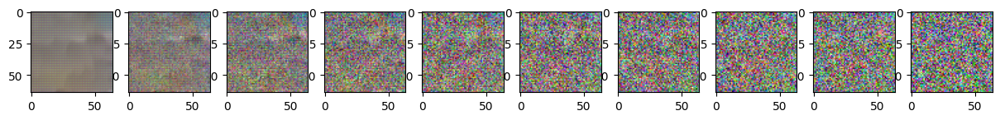

Epoch 140 | step 000 Loss: 0.13593393564224243 


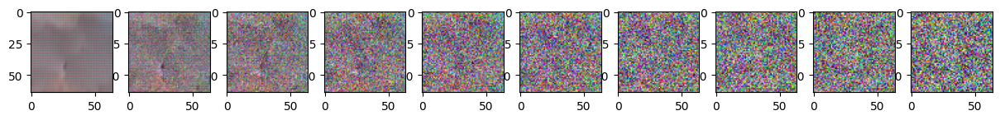

Epoch 145 | step 000 Loss: 0.13108095526695251 


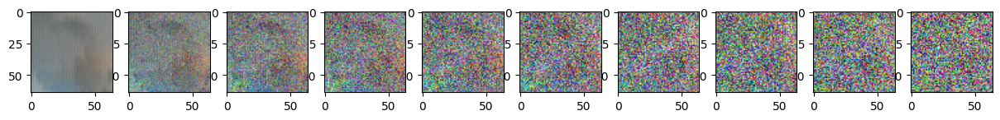

Epoch 150 | step 000 Loss: 0.12515601515769958 


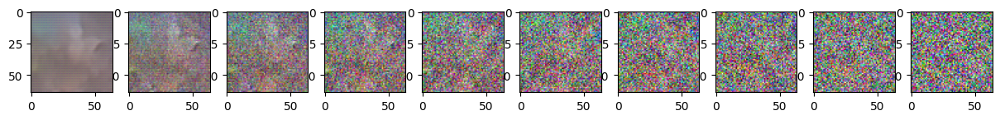

Epoch 155 | step 000 Loss: 0.13963547348976135 


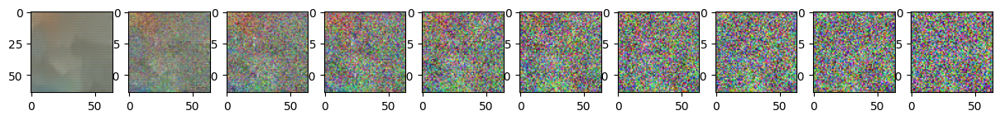

Epoch 160 | step 000 Loss: 0.1262720227241516 


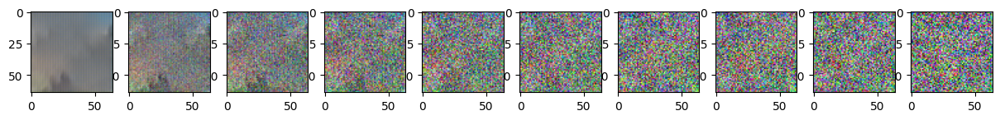

Epoch 165 | step 000 Loss: 0.1443895548582077 


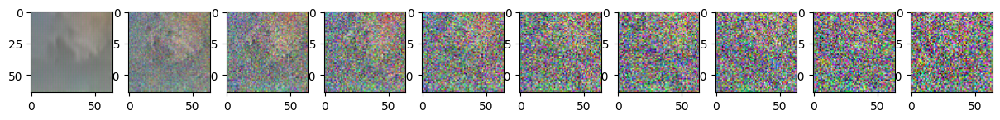

Epoch 170 | step 000 Loss: 0.13143625855445862 


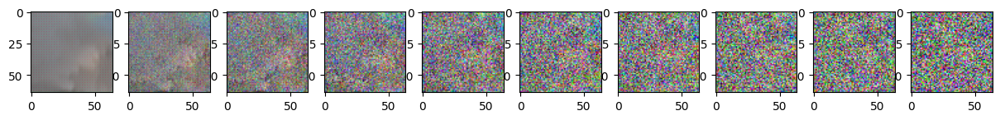

Epoch 175 | step 000 Loss: 0.13379740715026855 


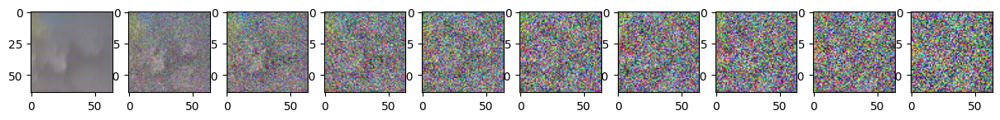

Epoch 180 | step 000 Loss: 0.13848227262496948 


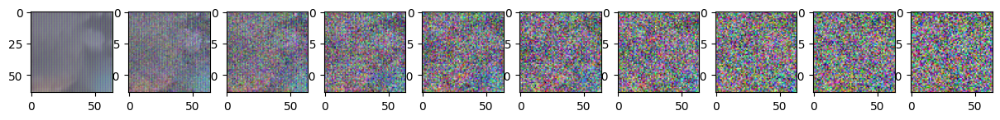

Epoch 185 | step 000 Loss: 0.15415209531784058 


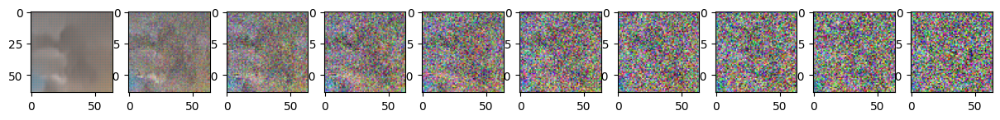

Epoch 190 | step 000 Loss: 0.15036022663116455 


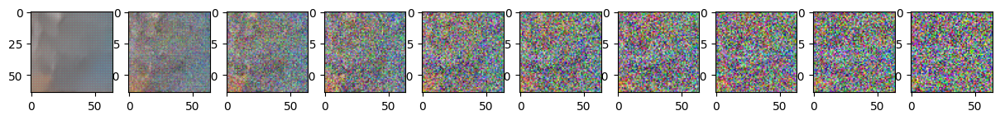

Epoch 195 | step 000 Loss: 0.1293744593858719 


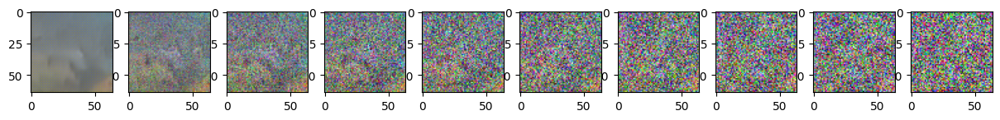

In [ ]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 200

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()